# Building Music Recommendation System using Spotify Dataset

Hello and welcome to my kernel. In this kernel, I have created Music Recommendation System using Spotify Dataset. To do this, I presented some of the visualization processes to understand data and done some EDA(Exploratory Data Analysis) so we can select features that are relevant to create a Recommendation System.

In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

In [10]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')
artist_data = pd.read_csv('data_by_artist.csv')

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [5]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [6]:
year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [7]:
year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [11]:
artist_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


The datasets are downloaded by a trusted and genuine source which is kaggle.com

We are going to check for all the analysis with the target as 'popularity'. Before going to do that let's check for the Feature Correlation by considering a few features and for that, I'm going to use the yellowbrick package.

Yellowbrick extends the Scikit-Learn API to make model selection and hyperparameter tuning easier. Under the hood, it’s using Matplotlib.


Correlation is a statistical term which in common usage refers to how close two variables are to having a linear relationship with each other.

For example, two variables which are linearly dependent (say, x and y which depend on each other as x = 2y) will have a higher correlation than two variables which are non-linearly dependent (say, u and v which depend on each other as u = v2)

Features with high correlation are more linearly dependent and hence have almost the same effect on the dependent variable. So, when two features have high correlation, we can drop one of the two features.

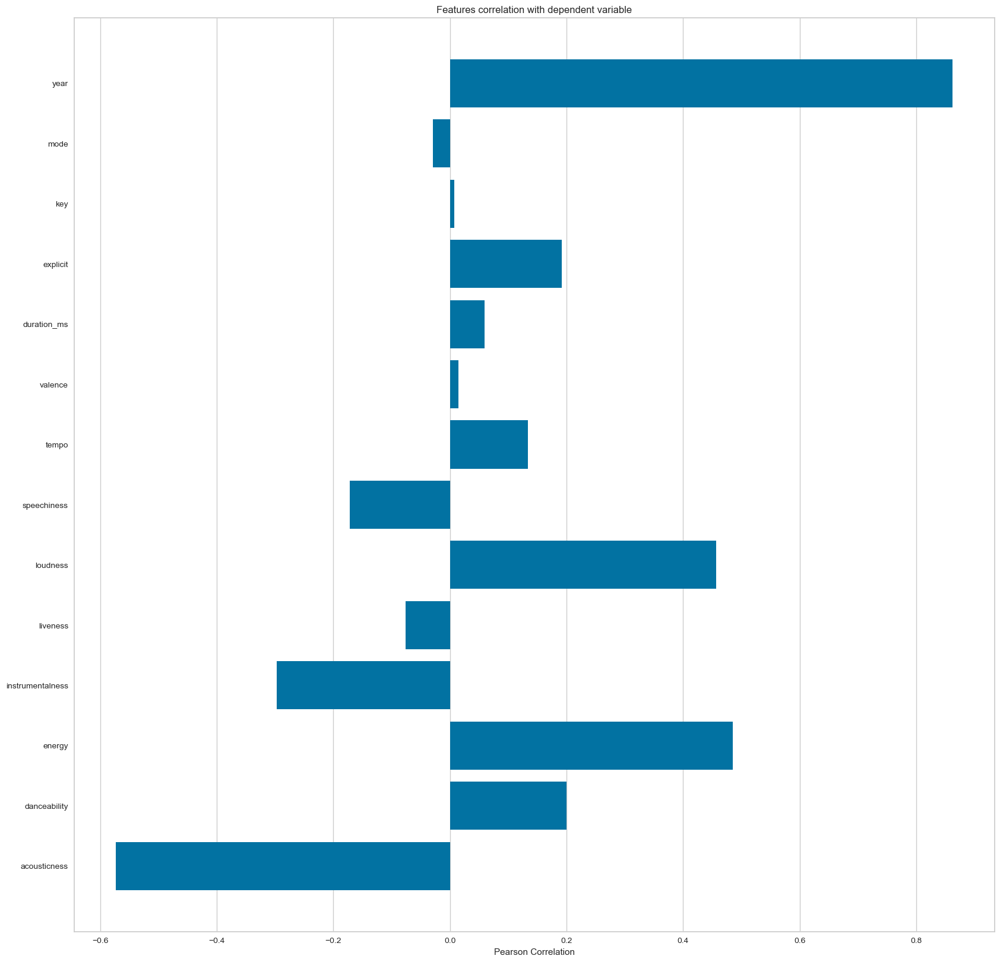

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [13]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

Data Understanding by Visualization and EDA

Exploratory Data Analysis (EDA) is a technique for analyzing and summarizing the main characteristics of a dataset. It involves using statistical and visualization techniques to describe the data. The goal of EDA is to explore, investigate, and learn, rather than confirm statistical hypotheses. 
EDA is an important first step in any data analysis. It identifies general patterns in the data, including outliers and unexpected features. For example, EDA can be used to visualize data to find that most customers buy 1-3 different types of shoes. 
The choice of EDA techniques depends on the information traits, research questions, and the insights sought from the analysis. 
Electronic Design Automation (EDA) refers to tools and hardware intellectual property (IP) development. In 2017, Siemens acquired Mentor Graphics and renamed it Siemens EDA in 2021. In 2012, Synopsys acquired Magma Design Automation. 

Music Over Time
Using the data grouped by year, we can understand how the overall sound of music has changed from 1921 to 2020.

In [ ]:
Visualizing the distribution of songs across decades

<Axes: xlabel='decade', ylabel='count'>

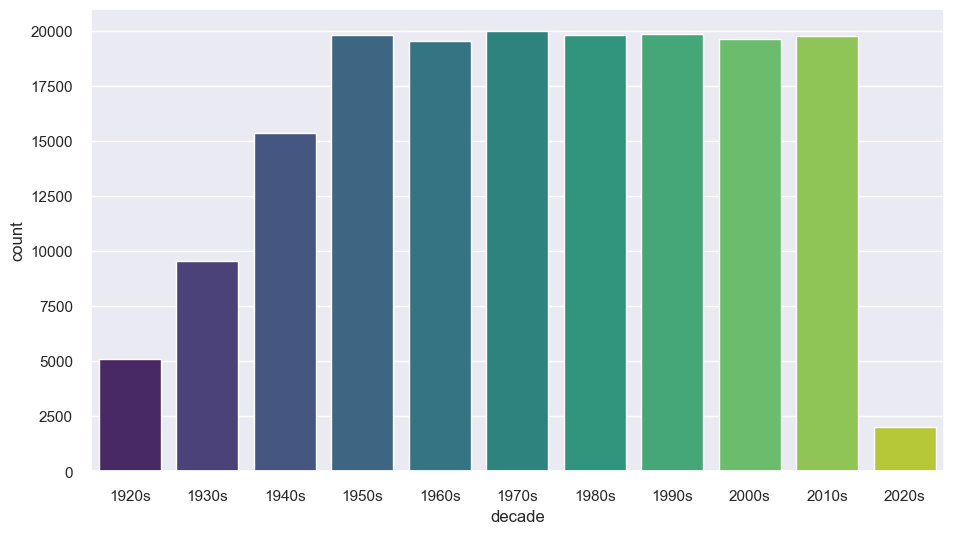

In [21]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(x='decade', data=data, palette='viridis')


In [30]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features,title='Trend of various sound features over decades')
fig.show()

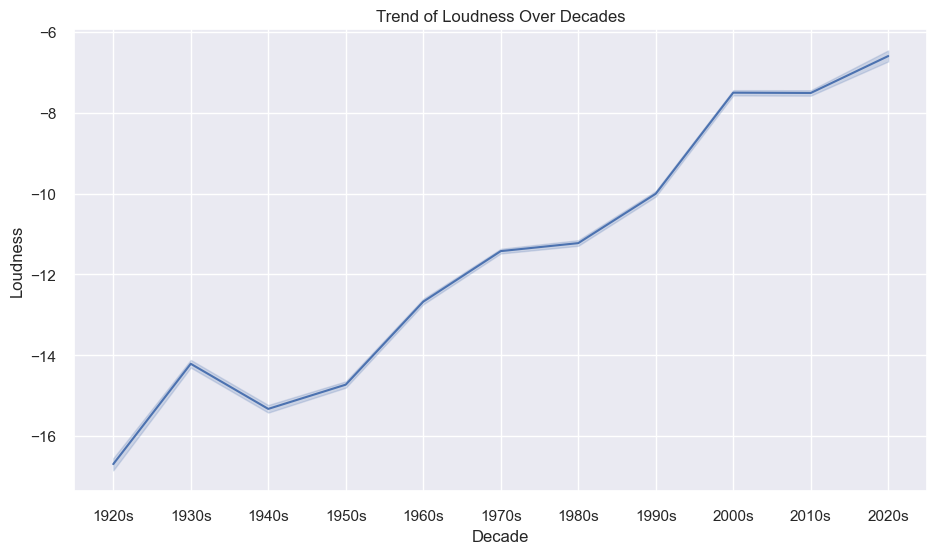

In [25]:
# Function to get decade from year
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

# Apply the get_decade function to create a 'decade' column
data['decade'] = data['year'].apply(get_decade)

# Set the figure size for the plot
sns.set(rc={'figure.figsize':(11, 6)})

# Create a line plot to show the trend of loudness over decades
sns.lineplot(x='decade', y='loudness', data=data)

# Set labels and title
plt.xlabel('Decade')
plt.ylabel('Loudness')
plt.title('Trend of Loudness Over Decades')

# Show the plot
plt.show()

Trend of various features over top 15 genres

In [32]:
top15_genres = genre_data.nlargest(15, 'popularity')

fig = px.bar(top15_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group',title='Trend of various features over top 15 genres')
fig.show()

Conclusions from EDA 

Most of the songs range between 1950s-2010
Energy in songs have increased over the time.
Acousticness in songs have reduces greately over the decades.
We can clearly see that loudness has dominantly increased over the decades and is at its peak in 2020.
In top 15 genres we can see that energy and dancebility are most noticeable features.

Clustering

Clustering is a data science technique in machine learning that groups similar rows in a data set. After running a clustering technique, a new column appears in the data set to indicate the group each row of data fits into best. Since rows of data, or data points, often represent people, financial transactions, documents or other important entities, these groups tend to form clusters of similar entities that have several kinds of real-world applications.

Clustering is sometimes referred to as unsupervised machine learning. To perform clustering, labels for past known outcomes -- a dependent, y, target or label variable -- are generally unnecessary. For example, when applying a clustering method in a mortgage loan application process, it's not necessary to know whether the applicants made their past mortgage payments. Rather, you need demographic, psychographic, behavioral, geographic or other information about the applicants in a mortgage portfolio. A clustering method will then attempt to group the applicants based on that information. This method stands in contrast to supervised learning, in which mortgage default risk for new applicants, for example, can be predicted based on patterns in data labeled with past default outcomes.

Since clustering generally groups input data, it can be very creative and flexible. Clustering can be used for data exploration and preprocessing, as well as specific applications. From a technical perspective, common applications of clustering include the following:

Data visualization. Data often contains natural groups or segments, and clustering should be able to find them. Visualizing clusters can be a highly informative data analysis approach.
Prototypes. Prototypes are data points that represent many other points and help explain data and models. If a cluster represents a large market segment, then the data point at the cluster center -- or cluster centroid -- is the prototypical member of that market segment.
Sampling. Since clustering can define groups in the data, clusters can be used to create different types of data samples. Drawing an equal number of data points from each cluster in a data set, for example, can create a balanced sample of the population represented by that data set.
Segments for models. Sometimes the predictive performance of supervised models -- regression, decision tree and neural networks, for example -- can be improved by using the information learned from unsupervised approaches such as clusters. Data scientists might include clusters as inputs to other models or build separate models for each cluster.
For business applications, clustering is a battle-tested tool in market segmentation and fraud detection. Clustering is also useful for categorizing documents, making product recommendations and in other applications where grouping entities makes sense.

We performed k-means clustering on the datasets to divide the dataset based on genre and songs.

In [33]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('kmeans', KMeans(n_clusters=10))  # Remove n_jobs parameter here
])

X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.named_steps['kmeans'].predict(X)

In [35]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'],title='Clusters of genres')
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.021s...
[t-SNE] Computed neighbors for 2973 samples in 0.535s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106300
[t-SNE] KL divergence after 1000 iterations: 1.391909


In [36]:
song_cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('kmeans', KMeans(n_clusters=20, verbose=False))  # Remove n_jobs parameter here
], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [38]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'],title='Cluster of Songs')
fig.show()

Model Bulding

In [40]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

%env SPOTIFY_CLIENT_ID= 05f87c2b3ca74f7a8a4558fb77706582
%env SPOTIFY_CLIENT_SECRET= d10b7d70018e4d18a90a3bfa89703099


sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"],
                                                           client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

env: SPOTIFY_CLIENT_ID=05f87c2b3ca74f7a8a4558fb77706582
env: SPOTIFY_CLIENT_SECRET=d10b7d70018e4d18a90a3bfa89703099


In [41]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [42]:
def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in the database'.format(song['name']))
            continue

        song_vector = song_data[number_cols].values
        if len(song_vector.shape) == 2:
            song_vector = song_vector[0]  # Extract values as a 1D array
        print(f'Song: {song["name"]}, Vector: {song_vector}')
        song_vectors.append(song_vector)

    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


Testing

In [43]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  data)


Couldn't read cache at: .cache


Song: Come As You Are, Vector: [0.539 1991 0.00016 0.5 218920 0.8240000000000001 0 0.00161 4 0.0916
 -5.846 0 72 0.0388 120.125]
Song: Smells Like Teen Spirit, Vector: [0.72 1991 2.55e-05 0.502 301920 0.912 0 0.000173 1 0.106 -4.556 1 75
 0.0564 116.761]
Song: Lithium, Vector: [0.388 1992 0.000203 0.688 259093 0.599 0 0.0 7 0.0782 -9.176 1 32 0.038
 123.265]
Song: All Apologies, Vector: [0.359 1993 0.0793 0.446 233173 0.632 0 0.000266 1 0.0881 -12.197 1 69
 0.034 113.176]


Couldn't write token to cache at: .cache
Couldn't read cache at: .cache
Couldn't write token to cache at: .cache


Song: Stay Away, Vector: [ 1.52000e-01  1.99300e+03  2.20000e-02  6.67000e-01  1.51891e+05
  6.36000e-01  1.00000e+00  0.00000e+00  8.00000e+00  9.08000e-02
 -5.66900e+00  1.00000e+00  5.80000e+01  8.20000e-02  1.58058e+02]


[{'name': 'My Wish', 'year': 2006, 'artists': "['Rascal Flatts']"},
 {'name': 'Sharp Dressed Man - 2008 Remaster',
  'year': 1983,
  'artists': "['ZZ Top']"},
 {'name': 'Nuestro Amor',
  'year': 2005,
  'artists': "['RBD', 'Anahí', 'Dulce María', 'Maite Perroni', 'Christian Chávez', 'Christopher von Uckermann', 'Alfonso Herrera']"},
 {'name': 'Believe', 'year': 1998, 'artists': "['Cher']"},
 {'name': 'Far Away', 'year': 2005, 'artists': "['Nickelback']"},
 {'name': 'Psychosocial', 'year': 2008, 'artists': "['Slipknot']"},
 {'name': 'Heart Of Glass (Live from the iHeart Festival)',
  'year': 2020,
  'artists': "['Miley Cyrus']"},
 {'name': "What I've Done", 'year': 2007, 'artists': "['Linkin Park']"},
 {'name': 'Infinity', 'year': 2015, 'artists': "['One Direction']"},
 {'name': 'Hanging By A Moment', 'year': 2000, 'artists': "['Lifehouse']"}]